In [1]:
%load_ext autoreload
%autoreload 2

import scanpy as sc
import yaml
import json
import os
from tools.hovernet_tools import map_cells_to_spots
from tools import slide_viz, slide_viz_int

PATH = '/home/luca/Documents/data/'
# '/cluster/CBIO/data1/lgortana/'
# '/home/luca/Documents/data_CBIO/'
# '/home/luca/Documents/data/'

/home/luca/anaconda3/envs/plugin-env/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Human Ovarian Carcinoma

## Load data

In [2]:
#load adata
adata_name = 'CytAssist_11mm_FFPE_Human_Ovarian_Carcinoma'
data_path = PATH + adata_name
path_ST_adata = data_path + '/ST'
adata = sc.read_visium(path_ST_adata)

#load image infos
json_path = data_path + '/seg_json/pannuke_fast_mask_lvl3.json'
with open(json_path) as json_file:
    hovernet_dict = json.load(json_file)

#image path
image_path = data_path + '/tif/CytAssist_11mm_FFPE_Human_Ovarian_Carcinoma_tissue_image.tif'

# Load the dictionary with the types and colors
dict_types_colors_path = "../config/dict_types_segmentation.yaml"
with open(dict_types_colors_path, 'r') as file:
    dict_types_colors = yaml.load(file, Loader=yaml.FullLoader)["pannuke"]

/home/luca/anaconda3/envs/plugin-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/luca/anaconda3/envs/plugin-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [3]:
ct_list = [item[0] for item in list(dict_types_colors.values())]

In [4]:
from tools.hovernet_tools import count_cell_types
count_cell_types(hovernet_dict, ct_list)

,neopla,connec,necros,nolabe,no-neo,inflam
0,252556,62523,3720,2794,4624,25876


## Plot slide and segmented nuclei

In [11]:
window = ((25000, 4000), (2000, 2000))

In [12]:
plotter = slide_viz.SlideVisualizer(image_path, 
                                    adata, 
                                    adata_name, 
                                    dict_cells = json_path,
                                    dict_types_colors=dict_types_colors,
                                    window = window)

Visium data found.


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


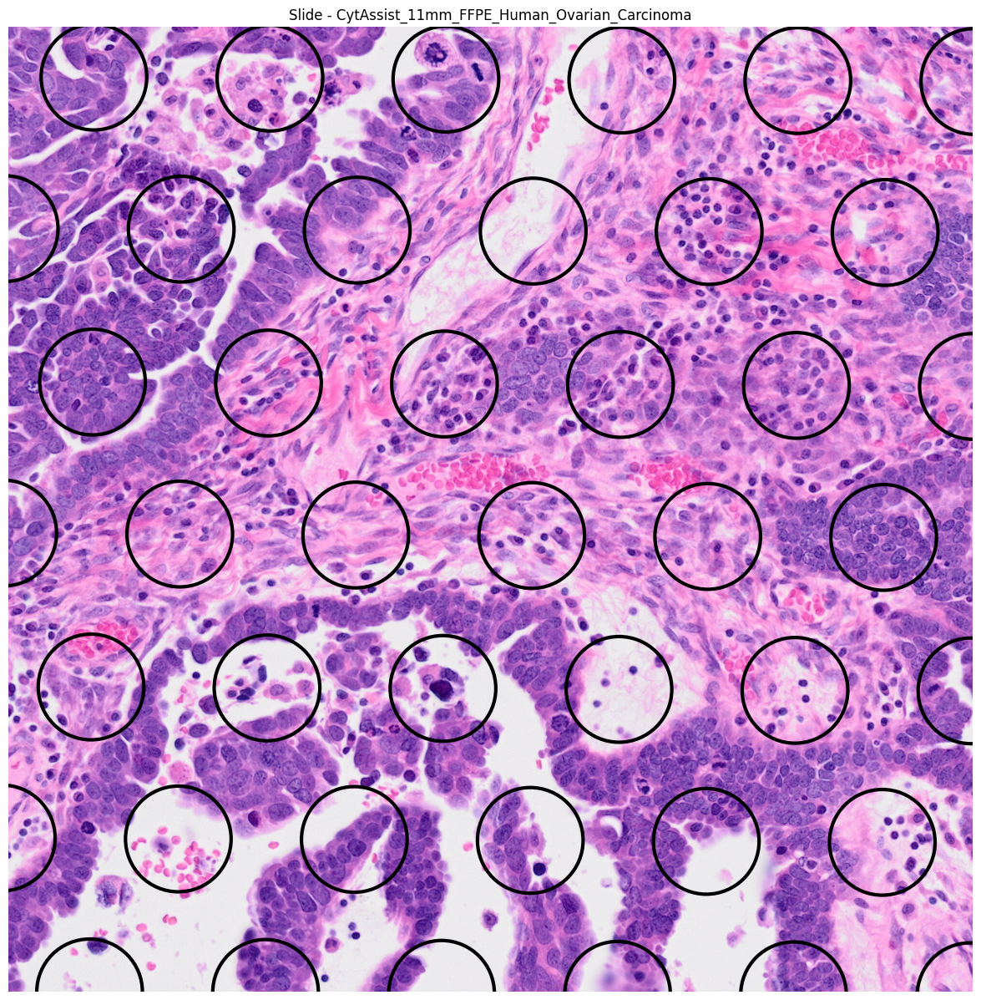

In [14]:
plotter.plot_slide(show_visium=True)

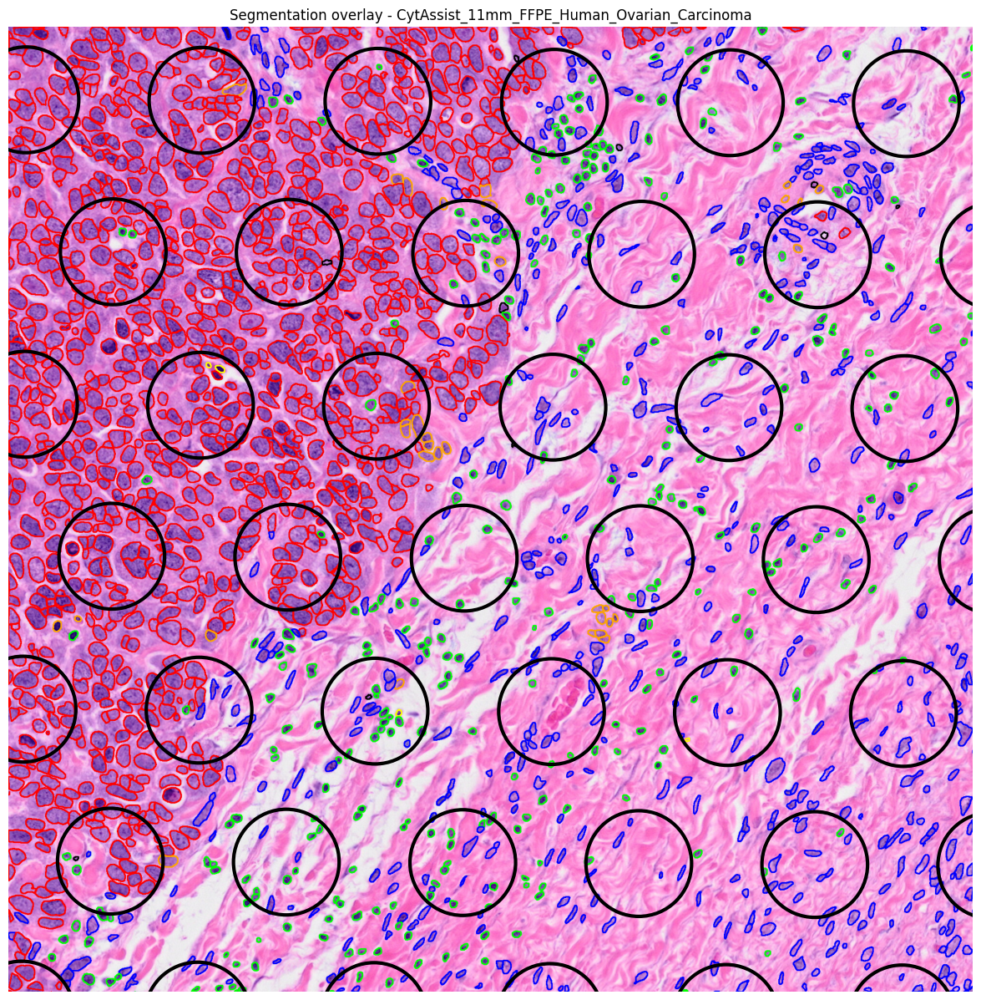

In [13]:
plotter.plot_seg(show_visium=True, draw_dot=False)

Visium data found.


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


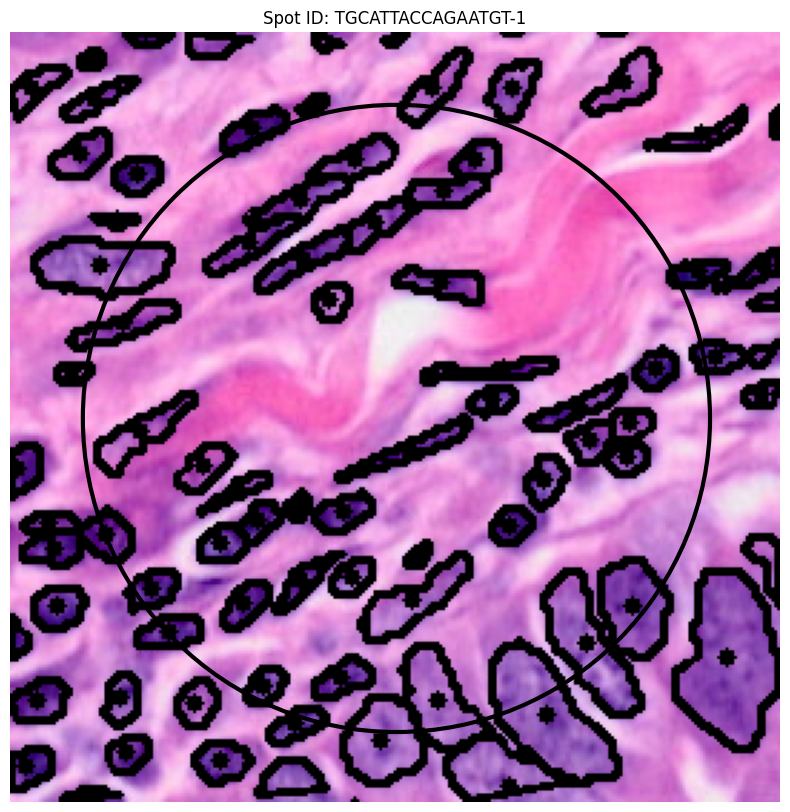

In [16]:
slide_viz.plot_specific_spot(image_path, 
                             adata, 
                             adata_name, 
                             spot_id="TGCATTACCAGAATGT-1", 
                             dict_cells=json_path, 
                             dict_types_colors=dict_types_colors["pannuke"])

In [9]:
plotter_int = slide_viz_int.SlideVisualizer(image_path, 
                                            adata, 
                                            adata_name, 
                                            dict_cells=json_path, 
                                            dict_types_colors=dict_types_colors, 
                                            window=window)

Visium data found.


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


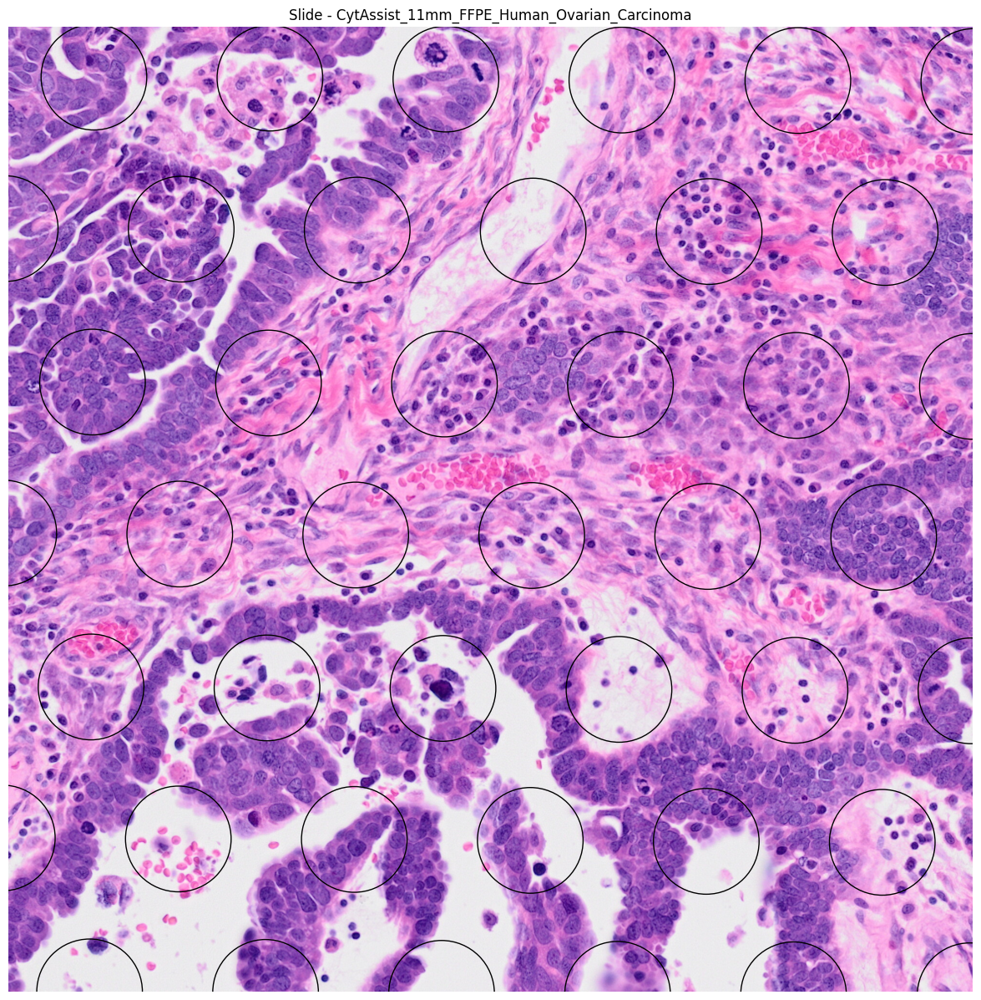

In [8]:
plotter_int.plot_slide(show_visium=True)

In [10]:
plotter_int.plot_seg(show_visium=True)

In [10]:
slide_viz_int.plot_specific_spot(image_path, 
                                 adata, 
                                 adata_name, 
                                 spot_id="GCCGTACAGTGGTAGA-1", 
                                 dict_cells=json_path, 
                                 dict_types_colors=dict_types_colors["pannuke"])

Visium data found.


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


In [11]:
# dict_cell2spot = map_cells_to_spots(adata, adata_name, json_path)

Mapping cells to spots: 100%|██████████| 352093/352093 [00:02<00:00, 139558.29it/s]


# Xenium Human Lung Cancer

## Load data

In [3]:
#load adata
adata_name = 'Xenium_V1_humanLung_Cancer_FFPE'
data_path = PATH + adata_name

#image path
image_path = data_path + '/tif/Xenium_V1_humanLung_Cancer_FFPE_he_image.ome.tif'

In [ ]:
plotter = slide_viz.SlideVisualizer(image_path, 
                          adata = adata, 
                          adata_name = adata_name, 
                          dict_cells = json_path,
                          window = window)

## Plot slide and segmented nuclei

## Extract tiles from Hovernet results

In [ ]:
# level = 0
# size = (64, 64)
# dict_types = {0 : "nolabe", 
#               1 : "neopla", 
#               2 : "inflam", 
#               3 : "connec", 
#               4 : "necros", 
#               5 : "no-neo"}
# out_dir = "data/CytAssist_11mm_FFPE_Human_Ovarian_Carcinoma/img/"

# extract_tiles_hovernet(image_path, json_path, dict_types, out_dir, level, size)

100%|██████████| 352093/352093 [25:06<00:00, 233.76it/s] 
